The goal of this notebook is to test is the Segment-Anything model from Meta could be used to smooth cost annotations.

In [2]:
from params import PROJECT_PATH
from PIL import Image
import numpy as np
from ipywidgets import interact
import matplotlib.pyplot as plt
from matplotlib import patches
from tqdm import tqdm
from functools import lru_cache

from pathlib import Path
from functools import reduce

In [3]:
dir_path = PROJECT_PATH / "bagfiles/images_extracted/"


def get_image(img_path: Path) -> np.array:
    with Image.open(img_path) as pil_img:
        return np.array(pil_img)


img = get_image(dir_path / "00024.png")
depth = get_image(dir_path / "00024d.png")
normal = get_image(dir_path / "00024n.png")

In [4]:
from segment_anything import SamAutomaticMaskGenerator, sam_model_registry

sam = sam_model_registry["vit_h"](checkpoint="sam_vit_h.pth").to("cuda")
mask_generator = SamAutomaticMaskGenerator(sam, stability_score_thresh=0.8)

In [5]:
masks = mask_generator.generate(img)

In [6]:
masks

[{'segmentation': array([[False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False],
         ...,
         [ True,  True,  True, ..., False, False, False],
         [ True,  True,  True, ..., False, False, False],
         [False, False, False, ..., False, False, False]]),
  'area': 18990,
  'bbox': [0, 905, 130, 173],
  'predicted_iou': 1.0145132541656494,
  'point_coords': [[90.0, 961.875]],
  'stability_score': 0.9899349808692932,
  'crop_box': [0, 0, 1920, 1080]},
 {'segmentation': array([[False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False],
         ...,
         [False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False]]),
  'area': 160643,
  'bbox': [0, 268, 1757

In [7]:
def random_color(_):
    return np.concatenate([np.random.random(3), [0.35]])


def mask_to_color_annotation(
    anns, color_fct=random_color, is_tqdm: bool = True
):
    if len(anns) == 0:
        return

    img = np.ones(
        (
            anns[0]["segmentation"].shape[0],
            anns[0]["segmentation"].shape[1],
            4,
        )
    )
    img[:, :, 3] = 0

    anns = sorted(anns, key=(lambda x: x["area"]), reverse=True)
    it = tqdm(anns) if is_tqdm else anns
    for ann in it:
        m = ann["segmentation"]
        color_mask = color_fct(ann)
        img[m] = color_mask

    return img


def get_color_annotation(img, *, color_fct=random_color):
    masks = mask_generator.generate(img)
    return mask_to_color_annotation(masks, color_fct=color_fct)


@interact()
def plot(img_path=dir_path.glob("*[!nd].png")):
    img = get_image(img_path)
    plt.imshow(img)

    color_mask = get_color_annotation(img)

    plt.gca().set_autoscale_on(False)
    plt.imshow(color_mask)

interactive(children=(Dropdown(description='img_path', options=(PosixPath('/home/g_thomas/Documents/PRE/bagfil…

# Removing intersection of masks
(Usefull to prevent any biais on the costmasp)

In [8]:
def filter_intersection(masks: list) -> list:
    if len(masks) == 0:
        raise ValueError("Empty list of masks provided.")

    union_mask = np.zeros_like(masks[0]["segmentation"], dtype=bool)
    exclusive_masks = []
    for mask in sorted(masks, key=(lambda x: x["area"])):
        new_segmentation = mask["segmentation"] & ~union_mask
        if new_segmentation.sum() == 0:
            continue

        exclusive_masks.append(
            {
                "segmentation": new_segmentation,
                "area": mask["area"],
            }
        )
        union_mask |= mask["segmentation"]

    return exclusive_masks


exclusive_masks = filter_intersection(masks)

In [9]:
%%script false --no-raise-error

color_mask = mask_to_color_annotation(masks)
color_exclusive_mask = mask_to_color_annotation(exclusive_masks)

_, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 15))
ax1.imshow(color_mask)
ax1.set_title(f"Previous masks\n{len(masks)} masks")
ax2.imshow(color_exclusive_mask)
ax2.set_title(f"Filtered masks\n{len(masks)} masks")

In [10]:
%%script false --no-raise-error

# Same nb of pxls?
nb_pxls = np.sum(reduce(np.logical_or, [m["segmentation"] for m in masks]))

nb_filtered_pxls = np.sum(
    reduce(np.logical_or, [m["segmentation"] for m in exclusive_masks])
)

nb_pxls, nb_filtered_pxls

In [11]:
%%script false --no-raise-error

nb_pxls = sum(np.sum(m["segmentation"]) for m in masks)
nb_filtered_pxls = sum(np.sum(m["segmentation"]) for m in exclusive_masks)

nb_pxls, nb_filtered_pxls

# Try coloring with our model's cost rather than random color

In [12]:
import sys

sys.path.append(str(PROJECT_PATH))

In [13]:
from src.data_preparation.create_dataset import (
    get_patch_dimension,
    RectangleDim,
)


def get_random_centroid(segmentation):
    y, x = np.nonzero(segmentation)
    i = np.random.randint(len(x))
    return x[i], y[i]


def keep_patch_inside(patch, segmentation):
    width, height = segmentation.shape
    crop_width = patch.max_x - patch.min_x
    crop_height = patch.max_y - patch.min_y

    min_x = max(patch.min_x, 0)
    min_y = max(patch.min_y, 0)

    max_x = patch.min_x + min(crop_width, width)
    max_y = patch.min_y + min(crop_height, height)

    return RectangleDim(min_x, max_x, min_y, max_y)


def get_random_patch(segmentation):
    point = get_random_centroid(segmentation)

    point = np.array([point])
    patch = get_patch_dimension(point)
    return keep_patch_inside(patch, segmentation)


def crop(img, patch):
    return img[patch.min_y : patch.max_y, patch.min_x : patch.max_x]

Failed to load Python extension for LZ4 support. LZ4 compression will not be available.


  0%|          | 0/1 [00:00<?, ?it/s]

100%|██████████| 1/1 [00:00<00:00, 132.38it/s]


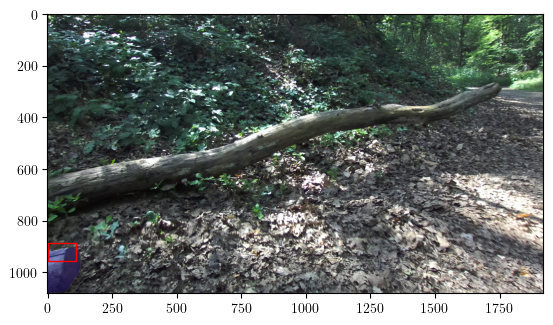

In [14]:
plt.imshow(img)
color_mask = mask_to_color_annotation([masks[0]])

plt.gca().set_autoscale_on(False)
plt.imshow(color_mask)

patch = get_random_patch(masks[0]["segmentation"])
rect = patches.Rectangle(
    (patch.min_x, patch.min_y),
    patch.max_x - patch.min_x,
    patch.max_y - patch.min_y,
    linewidth=1,
    edgecolor="r",
    facecolor="none",
)
plt.gca().add_patch(rect)

In [15]:
import torch

from src.models_development.multimodal_velocity_regression_alt.model import (
    ResNet18Velocity_Regression_Alt,
)


model = ResNet18Velocity_Regression_Alt()
WEIGHTS = (
    PROJECT_PATH
    / "src/models_development/multimodal_velocity_regression_alt/logs/_post_hp_tuning/network.params"
)
model.load_state_dict(torch.load(WEIGHTS))
model.eval().to("cuda")

ResNet18Velocity_Regression_Alt(
  (resnet18): ResNet(
    (conv1): Conv2d(7, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.

In [17]:
import matplotlib.cm as cmx
import matplotlib.colors as colors

from results_quantifier import get_model_input

norm = colors.Normalize(vmin=3, vmax=6)
colormap = cmx.ScalarMappable(norm=norm, cmap="hot_r")


def get_cost(mask, img, depth, normal, *, nb_patch: int = 10) -> float:
    seg = mask["segmentation"]

    bottom_mask = np.zeros_like(seg, dtype=bool)
    half_height = seg.shape[0] // 2
    bottom_mask[half_height:, :] = 1

    # The mask is not on the bottom half of the image
    if not np.any(seg & bottom_mask):
        return 0

    costs = []
    for _ in range(nb_patch):
        patch = get_random_patch(seg)

        img_crop = crop(img, patch)
        depth_crop = crop(depth, patch)
        normal_crop = crop(normal, patch)

        input = get_model_input(img_crop, depth_crop, normal_crop, 1)
        output = model(*input).cpu().item()
        costs.append(output)

    return np.mean(costs)


def get_color_by_cost(
    mask, img, depth, normal, *, nb_patch: int = 10, alpha: float = 0.55
) -> np.array:
    cost = get_cost(mask, img, depth, normal, nb_patch=nb_patch)
    if cost == 0:
        return np.array([0, 0, 0, 0])

    return colormap.to_rgba(cost, alpha=alpha)

In [18]:
%%script false --no-raise-error

plt.imshow(img)
color_mask = mask_to_color_annotation(
    masks, color_fct=lambda mask: get_color_by_cost(mask, img, depth, normal)
)
plt.gca().set_autoscale_on(False)
plt.imshow(color_mask)

# Regrouping everything

In [19]:
@lru_cache
def get_colored_sam_costmap(img_path: Path):
    img = get_image(img_path)
    depth = get_image(img_path.parent / (img_path.stem + "d.png"))
    normal = get_image(img_path.parent / (img_path.stem + "n.png"))

    masks = mask_generator.generate(img)
    masks = filter_intersection(masks)
    color_mask = mask_to_color_annotation(
        masks,
        color_fct=lambda mask: get_color_by_cost(
            mask, img, depth, normal, alpha=1
        ),
        is_tqdm=False,
    )
    return img, color_mask

In [20]:
def plot_sam_costmap(img_path: Path):
    img, color_mask = get_colored_sam_costmap(img_path)
    _, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(15, 5))
    ax1.imshow(img)
    ax1.set_title(f"Original image ({img_path.stem})")

    masks = mask_generator.generate(img)
    all_masks = mask_to_color_annotation(masks)
    ax2.imshow(all_masks)

    segmented_pxl = np.sum(
        reduce(np.logical_or, [m["segmentation"] for m in masks])
    )
    all_pxl = np.prod(img.shape[:2])
    ax2.set_title(
        "All masks (random color)\n"
        f"Completeness: {segmented_pxl / all_pxl * 100:.2f}%"
    )

    density = np.sum([m["segmentation"] for m in masks], axis=0)
    density_cmap = ax3.imshow(density, cmap="hot")
    ax3.set_title("Masks density\n" f"Number of masks: {len(masks)}")

    # ax4.imshow(img)
    # ax4.set_autoscale_on(False)
    ax4.imshow(color_mask)
    ax4.set_title("Costmap")

    plt.colorbar(density_cmap, ax=ax3, shrink=0.5)
    plt.colorbar(colormap, ax=ax4, shrink=0.5)

In [21]:
%%script false --no-raise-error

for img_path in tqdm(list(dir_path.glob("*[!nd].png")), desc="Precomputing"):
    get_colored_sam_costmap(img_path)

In [22]:
%%script false --no-raise-error

@interact()
def plot(img_path=dir_path.glob("*[!nd].png")):
    plot_sam_costmap(img_path)

interactive(children=(Dropdown(description='img_path', options=(PosixPath('/home/g_thomas/Documents/PRE/bagfil…

# How to improve stability of the costmap?
i.e. from run to run, the costmap regurlarly changes a lot.

This is due to the random sampling of the patches's position to infer traversability cost. One time, some patches might be too much on the edge and hence bias the costmap.

In [142]:
img_path = dir_path / "2.png"
img = get_image(img_path)
depth = get_image(img_path.parent / (img_path.stem + "d.png"))
normal = get_image(img_path.parent / (img_path.stem + "n.png"))
masks = mask_generator.generate(img)

  0%|          | 0/1 [00:00<?, ?it/s]

100%|██████████| 1/1 [00:00<00:00, 48.49it/s]


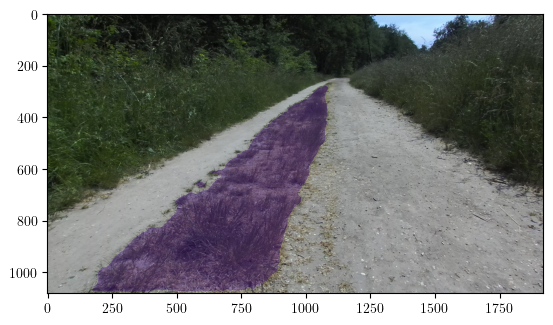

In [150]:
plt.imshow(img)
color_mask = mask_to_color_annotation([masks[0]])

plt.gca().set_autoscale_on(False)
plt.imshow(color_mask)

In [151]:
segmentation = masks[0]["segmentation"]
nb_patch = 10
costs = []
patches_list = []

for _ in range(nb_patch):
    patch = get_random_patch(segmentation)
    patches_list.append(patch)

    img_crop = crop(img, patch)
    depth_crop = crop(depth, patch)
    normal_crop = crop(normal, patch)

    input = get_model_input(img_crop, depth_crop, normal_crop, 1)
    output = model(*input).cpu().item()
    costs.append(output)

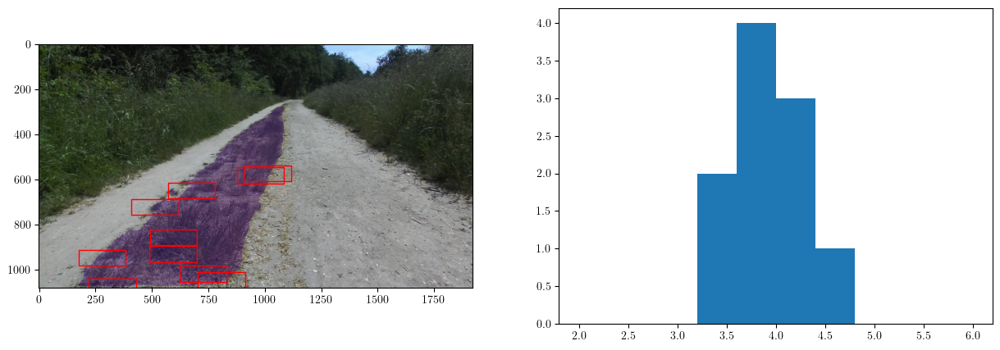

In [152]:
def plot_patches(
    img: np.array, color_mask: np.array, patches_list: list, costs: list
) -> None:
    _, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))
    ax2.hist(costs, range=(2, 6))
    ax1.imshow(img)

    for patch in patches_list:
        rect = patches.Rectangle(
            (patch.min_x, patch.min_y),
            patch.max_x - patch.min_x,
            patch.max_y - patch.min_y,
            linewidth=1,
            edgecolor="r",
            facecolor="none",
        )
        ax1.add_patch(rect)
    ax1.set_autoscale_on(False)
    ax1.imshow(color_mask)


plot_patches(img, color_mask, patches_list, costs)

In [63]:
def compute_entropy(
    get_cost,
    mask: np.array,
    img: np.array,
    depth: np.array,
    normal: np.array,
    *,
    nb_calls: int = 100,
):
    costs = []
    for _ in range(nb_calls):
        cost = get_cost(mask, img, depth, normal)
        costs.append(cost)

    return np.std(costs)


default_strategy_entropy = compute_entropy(
    get_cost, masks[0], img, depth, normal
)
default_strategy_entropy

0.15519545795369932

## Effect of nb_patch

In [157]:
nb_patch_list = np.geomspace(10, 200, 5, dtype=int)

default_entropy_list = []
for nb_patch in tqdm(nb_patch_list, desc="Computing stability"):
    entropy = compute_entropy(
        lambda mask, img, depth, normal: get_cost(
            mask, img, depth, normal, nb_patch=nb_patch
        ),
        masks[0],
        img,
        depth,
        normal,
    )
    default_entropy_list.append(entropy)

Computing stability: 100%|██████████| 5/5 [05:09<00:00, 61.97s/it]


Text(0.5, 1.0, 'Stability of the costmap for the default cost computation strategy')

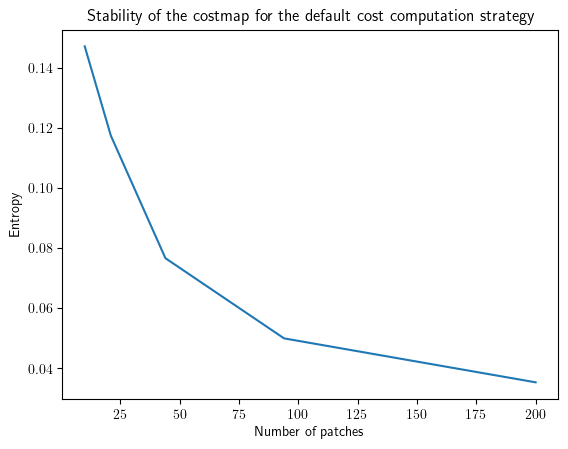

In [158]:
plt.plot(nb_patch_list, default_entropy_list)
plt.ylabel("Entropy")
plt.xlabel("Number of patches")
plt.title("Stability of the costmap for the default cost computation strategy")

## Take the most centered patches?

In [66]:
def _compute_intersection(segmentation, patch):
    segmentation_crop = crop(segmentation, patch)
    nb_mask_pixels = np.sum(segmentation_crop)
    nb_pixels = np.prod(segmentation_crop.shape)
    return nb_mask_pixels / nb_pixels


def get_cost_with_most_centered_patches(
    mask,
    img,
    depth,
    normal,
    *,
    nb_total_patch: int = 20,
    nb_centered_patch: int = 10
) -> float:
    seg = mask["segmentation"]

    bottom_mask = np.zeros_like(seg, dtype=bool)
    half_height = seg.shape[0] // 2
    bottom_mask[half_height:, :] = 1

    # The mask is not on the bottom half of the image
    if not np.any(seg & bottom_mask):
        return 0

    patches = []
    for _ in range(nb_total_patch):
        patch = get_random_patch(seg)
        patches.append(patch)

    most_centered_patches = sorted(
        patches,
        key=lambda patch: _compute_intersection(seg, patch),
        reverse=True,
    )

    costs = []
    for patch in most_centered_patches[:nb_centered_patch]:
        img_crop = crop(img, patch)
        depth_crop = crop(depth, patch)
        normal_crop = crop(normal, patch)

        input = get_model_input(img_crop, depth_crop, normal_crop, 1)
        output = model(*input).cpu().item()
        costs.append(output)

    return np.mean(costs)

In [69]:
centered_strategy_entropy = compute_entropy(
    get_cost_with_most_centered_patches, masks[0], img, depth, normal
)
centered_strategy_entropy

0.12531946670486016

In [101]:
nb_patch_list = np.geomspace(10, 200, 5, dtype=int)
pourcentage_list = np.linspace(10, 100, 5, dtype=int)

entropy_list = {}
for pourcentage in tqdm(pourcentage_list, desc="Computing stability"):
    entropy_list[pourcentage] = []
    for nb_patch in nb_patch_list:
        entropy = compute_entropy(
            lambda mask, img, depth, normal: get_cost_with_most_centered_patches(
                mask,
                img,
                depth,
                normal,
                nb_total_patch=nb_patch,
                nb_centered_patch=nb_patch * pourcentage // 100,
            ),
            masks[0],
            img,
            depth,
            normal,
        )
        entropy_list[pourcentage].append(entropy)

Computing stability: 100%|██████████| 5/5 [17:07<00:00, 205.60s/it]


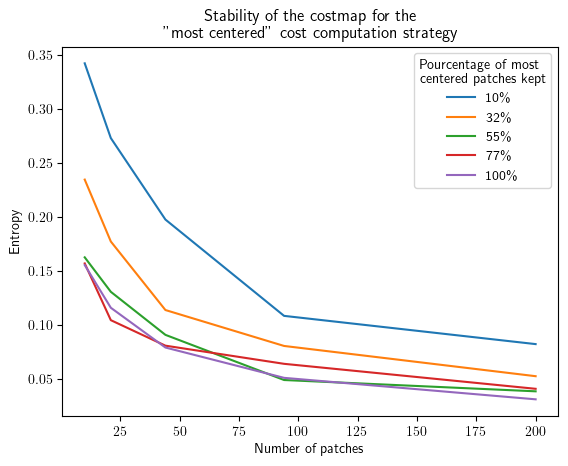

In [116]:
for pourcentage in pourcentage_list:
    plt.plot(
        nb_patch_list,
        entropy_list[pourcentage],
        label=f"{pourcentage}\%",
    )

plt.ylabel("Entropy")
plt.xlabel("Number of patches")
plt.title(
    'Stability of the costmap for the\n"most centered" cost computation strategy'
)
plt.legend(title="Pourcentage of most\ncentered patches kept")

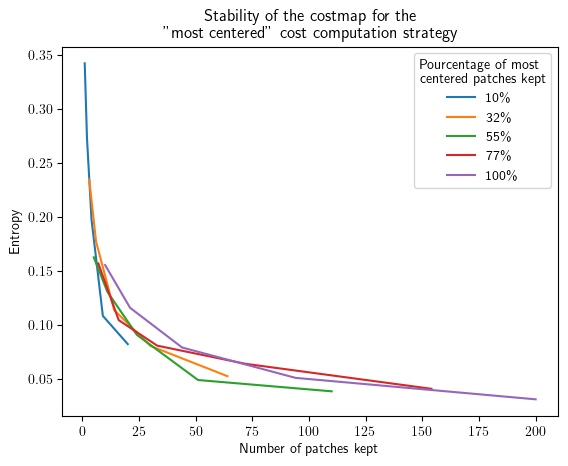

In [117]:
for pourcentage in pourcentage_list:
    nb_patch_kept = [
        nb_patch * pourcentage // 100 for nb_patch in nb_patch_list
    ]
    plt.plot(
        nb_patch_kept,
        entropy_list[pourcentage],
        label=f"{pourcentage}\%",
    )

plt.ylabel("Entropy")
plt.xlabel("Number of patches kept")
plt.title(
    'Stability of the costmap for the\n"most centered" cost computation strategy'
)
plt.legend(title="Pourcentage of most\ncentered patches kept")

## Interquartiles mean
Not so much effect...

In [94]:
def get_iqm_cost_with_most_centered_patches(
    mask,
    img,
    depth,
    normal,
    *,
    nb_total_patch: int = 20,
    nb_centered_patch: int = 10,
) -> float:
    seg = mask["segmentation"]

    bottom_mask = np.zeros_like(seg, dtype=bool)
    half_height = seg.shape[0] // 2
    bottom_mask[half_height:, :] = 1

    # The mask is not on the bottom half of the image
    if not np.any(seg & bottom_mask):
        return 0

    patches = []
    for _ in range(nb_total_patch):
        patch = get_random_patch(seg)
        patches.append(patch)

    most_centered_patches = sorted(
        patches,
        key=lambda patch: _compute_intersection(seg, patch),
        reverse=True,
    )

    costs = []
    for patch in most_centered_patches[:nb_centered_patch]:
        img_crop = crop(img, patch)
        depth_crop = crop(depth, patch)
        normal_crop = crop(normal, patch)

        input = get_model_input(img_crop, depth_crop, normal_crop, 1)
        output = model(*input).cpu().item()
        costs.append(output)

    q1, q3 = np.percentile(costs, [25, 75])
    filtered_costs = [cost for cost in costs if q1 <= cost <= q3]
    if filtered_costs == []:
        # When not enough values in costs
        return np.mean(costs)

    return np.mean(filtered_costs)

In [103]:
iqm_entropy_list = {}
for pourcentage in tqdm(pourcentage_list, desc="Computing stability"):
    iqm_entropy_list[pourcentage] = []
    for nb_patch in nb_patch_list:
        entropy = compute_entropy(
            lambda mask, img, depth, normal: get_iqm_cost_with_most_centered_patches(
                mask,
                img,
                depth,
                normal,
                nb_total_patch=nb_patch,
                nb_centered_patch=nb_patch * pourcentage // 100,
            ),
            masks[0],
            img,
            depth,
            normal,
        )
        iqm_entropy_list[pourcentage].append(entropy)

Computing stability: 100%|██████████| 5/5 [17:07<00:00, 205.54s/it]


(0.0, 0.5)

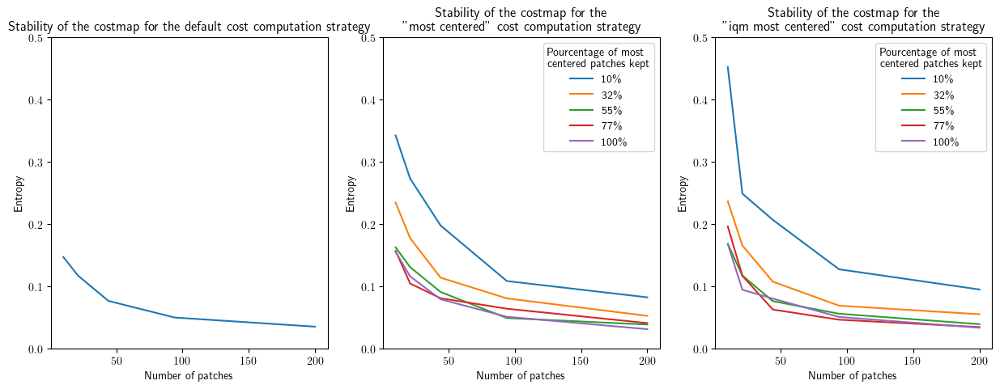

In [160]:
_, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 5))
ylim = (0, 0.5)

ax1.plot(nb_patch_list, default_entropy_list)
ax1.set_ylabel("Entropy")
ax1.set_xlabel("Number of patches")
ax1.set_title(
    "Stability of the costmap for the default cost computation strategy"
)
ax1.set_ylim(ylim)

for pourcentage in pourcentage_list:
    ax2.plot(
        nb_patch_list, entropy_list[pourcentage], label=f"{pourcentage}\%"
    )
ax2.set_ylabel("Entropy")
ax2.set_xlabel("Number of patches")
ax2.set_title(
    'Stability of the costmap for the\n"most centered" cost computation strategy'
)
ax2.legend(title="Pourcentage of most\ncentered patches kept")
ax2.set_ylim(ylim)

for pourcentage in iqm_entropy_list:
    ax3.plot(
        nb_patch_list, iqm_entropy_list[pourcentage], label=f"{pourcentage}\%"
    )

ax3.set_ylabel("Entropy")
ax3.set_xlabel("Number of patches")
ax3.set_title(
    'Stability of the costmap for the\n"iqm most centered" cost computation strategy'
)
ax3.legend(title="Pourcentage of most\ncentered patches kept")
ax3.set_ylim(ylim)

(0.0, 0.5)

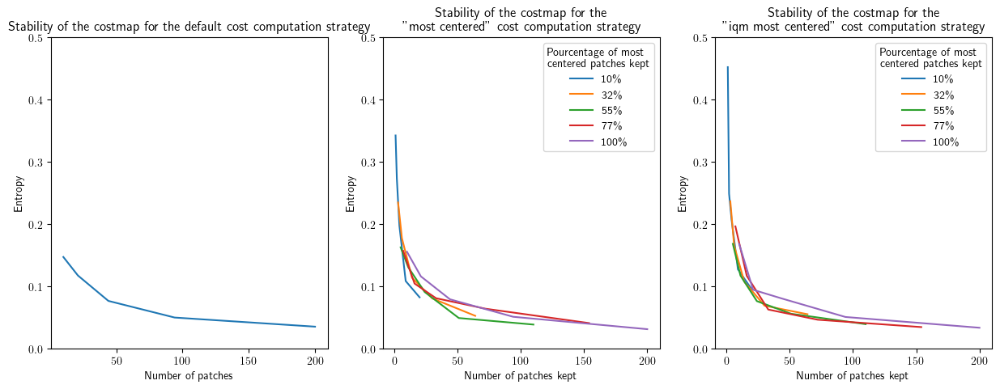

In [161]:
_, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 5))
ylim = (0, 0.5)
ax1.plot(nb_patch_list, default_entropy_list)
ax1.set_ylabel("Entropy")
ax1.set_xlabel("Number of patches")
ax1.set_title(
    "Stability of the costmap for the default cost computation strategy"
)
ax1.set_ylim(ylim)

for pourcentage in pourcentage_list:
    nb_patch_kept = [
        nb_patch * pourcentage // 100 for nb_patch in nb_patch_list
    ]
    ax2.plot(
        nb_patch_kept, entropy_list[pourcentage], label=f"{pourcentage}\%"
    )

ax2.set_ylabel("Entropy")
ax2.set_xlabel("Number of patches kept")
ax2.set_title(
    'Stability of the costmap for the\n"most centered" cost computation strategy'
)
ax2.legend(title="Pourcentage of most\ncentered patches kept")
ax2.set_ylim(ylim)


for pourcentage in iqm_entropy_list:
    nb_patch_kept = [
        nb_patch * pourcentage // 100 for nb_patch in nb_patch_list
    ]
    ax3.plot(
        nb_patch_kept, iqm_entropy_list[pourcentage], label=f"{pourcentage}\%"
    )

ax3.set_ylabel("Entropy")
ax3.set_xlabel("Number of patches kept")
ax3.set_title(
    'Stability of the costmap for the\n"iqm most centered" cost computation strategy'
)
ax3.legend(title="Pourcentage of most\ncentered patches kept")
ax3.set_ylim(ylim)

In [154]:
nb_total_patch = 100
nb_centered_patch = 50
new_patches = []
for _ in range(nb_total_patch):
    patch = get_random_patch(masks[0]["segmentation"])
    new_patches.append(patch)

new_most_centered_patches = sorted(
    new_patches,
    key=lambda patch: _compute_intersection(masks[0]["segmentation"], patch),
    reverse=True,
)

new_costs = []
for patch in new_most_centered_patches[:nb_centered_patch]:
    img_crop = crop(img, patch)
    depth_crop = crop(depth, patch)
    normal_crop = crop(normal, patch)

    input = get_model_input(img_crop, depth_crop, normal_crop, 1)
    output = model(*input).cpu().item()
    new_costs.append(output)

In [155]:
len(new_most_centered_patches)

100

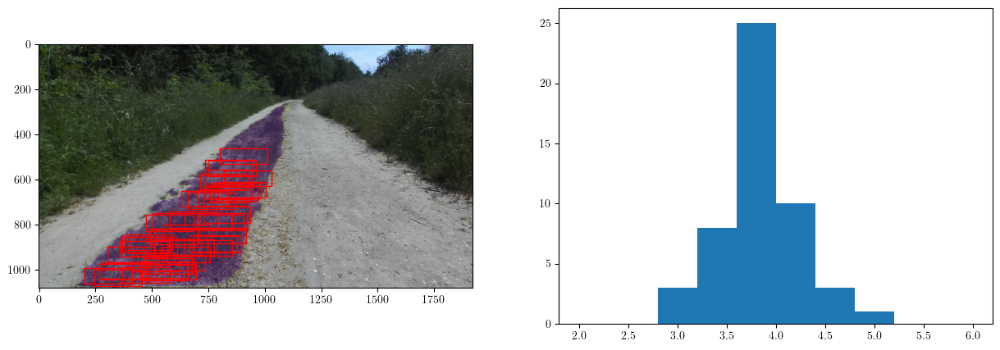

In [156]:
plot_patches(
    img, color_mask, new_most_centered_patches[:nb_centered_patch], new_costs
)

In [ ]:
def tmp_get_color_by_cost(
    mask, img, depth, normal, *, alpha: float = 0.55
) -> np.array:
    cost = get_iqm_cost_with_most_centered_patches(
        mask, img, depth, normal, nb_total_patch=50, nb_centered_patch=25
    )
    if cost == 0:
        return np.array([0, 0, 0, 0])

    return colormap.to_rgba(cost, alpha=alpha)


def plot():
    img = get_image(img_path)
    depth = get_image(img_path.parent / (img_path.stem + "d.png"))
    normal = get_image(img_path.parent / (img_path.stem + "n.png"))

    masks = mask_generator.generate(img)
    masks = filter_intersection(masks)
    color_mask = mask_to_color_annotation(
        masks,
        color_fct=lambda mask: tmp_get_color_by_cost(
            mask, img, depth, normal, alpha=1
        ),
        is_tqdm=False,
    )

    _, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))
    ax1.imshow(img)
    ax2.imshow(color_mask)

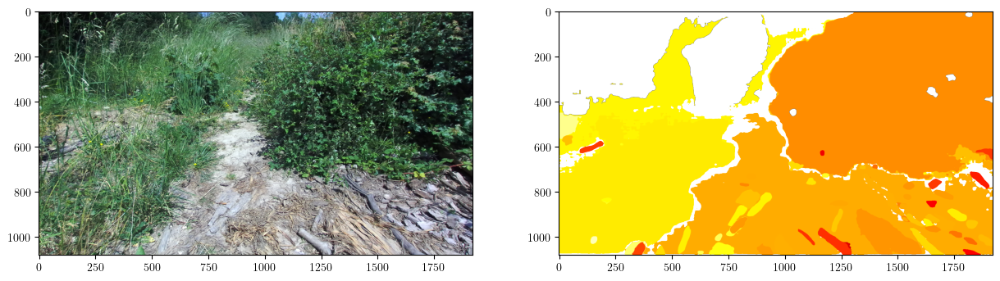

In [163]:
img_path = dir_path / "00015.png"
img = get_image(img_path)
depth = get_image(img_path.parent / (img_path.stem + "d.png"))
normal = get_image(img_path.parent / (img_path.stem + "n.png"))
masks = mask_generator.generate(img)

plot()

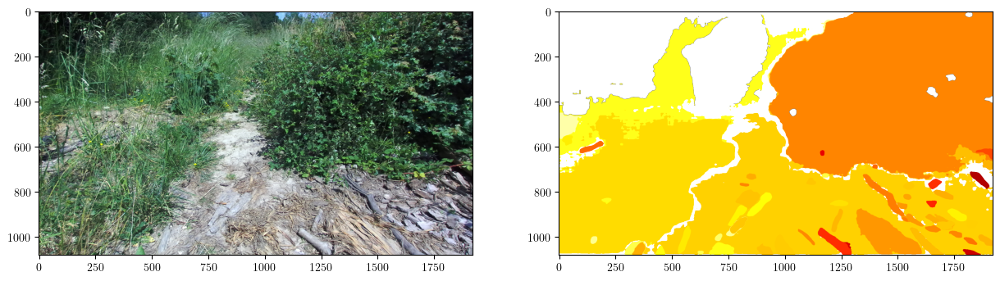

In [164]:
plot()

# Possible to tune SAM's parameters to solve undersegmentation and too-large patches?

## Manual approach

In [14]:
too_large_path = [
    "00015.png",
    "5.png",
    "00053.png",
    "6.png",
    "00048.png",
    "9.png",
]

lack_patches_path = [
    "00006.png",
    "00079.png",
    "00000.png",
    "00019.png",
    "11.png",
    "11.png",
]

normal_path = [
    "15.png",
    "12.png",
    "3.png",
    "2.png",
    "00037.png",
    "00027.png",
]

nb_line = len(too_large_path)


def plot_img_and_annot(mask_generator, axes, img_path):
    ax1, ax2 = axes

    img = get_image(img_path)
    ax1.imshow(img)

    masks = mask_generator.generate(img)
    color_mask = mask_to_color_annotation(masks, is_tqdm=False)
    ax2.imshow(color_mask)
    ax2.set_title(f"nb masks: {len(masks)}")


def plot_tuned_SAM(**kwargs):
    mask_generator = SamAutomaticMaskGenerator(sam, **kwargs)
    _, ax_grid = plt.subplots(nb_line, 8, figsize=(5 * 8, 5 * nb_line))
    for i in tqdm(np.arange(nb_line)):
        plot_img_and_annot(
            mask_generator, ax_grid[i, 0:2], dir_path / too_large_path[i]
        )
        plot_img_and_annot(
            mask_generator, ax_grid[i, 3:5], dir_path / lack_patches_path[i]
        )
        plot_img_and_annot(
            mask_generator, ax_grid[i, 6:8], dir_path / normal_path[i]
        )

100%|██████████| 6/6 [05:14<00:00, 52.43s/it]


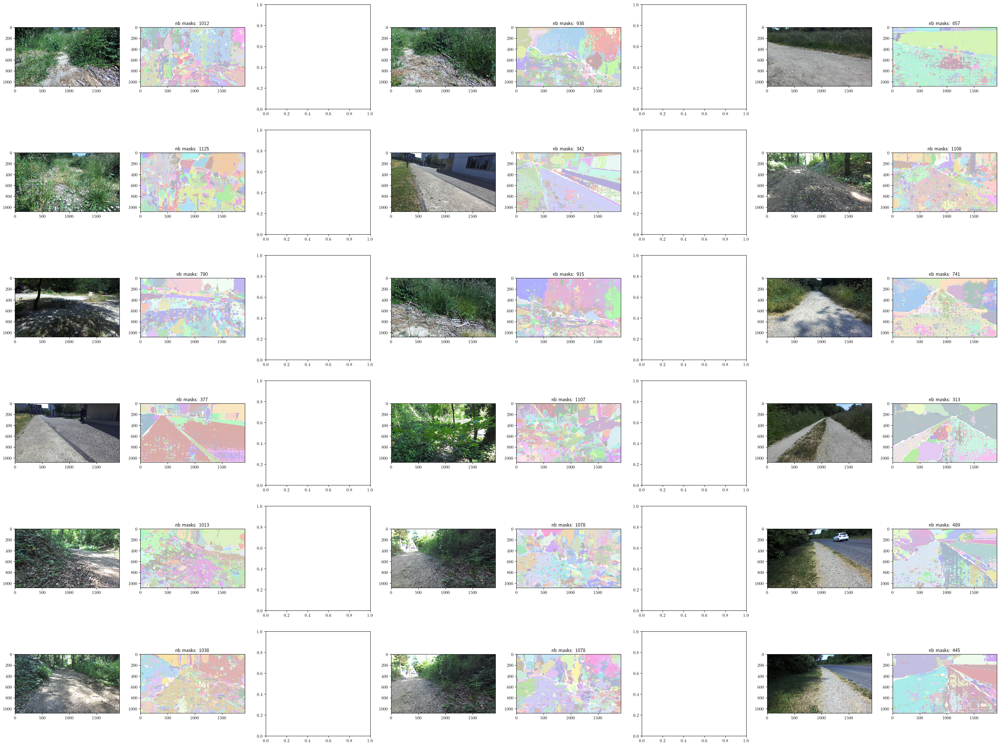

In [15]:
# No filter?
plot_tuned_SAM(
    pred_iou_thresh=0.0, stability_score_thresh=0.0, stability_score_offset=0.0
)

100%|██████████| 6/6 [01:35<00:00, 15.84s/it]


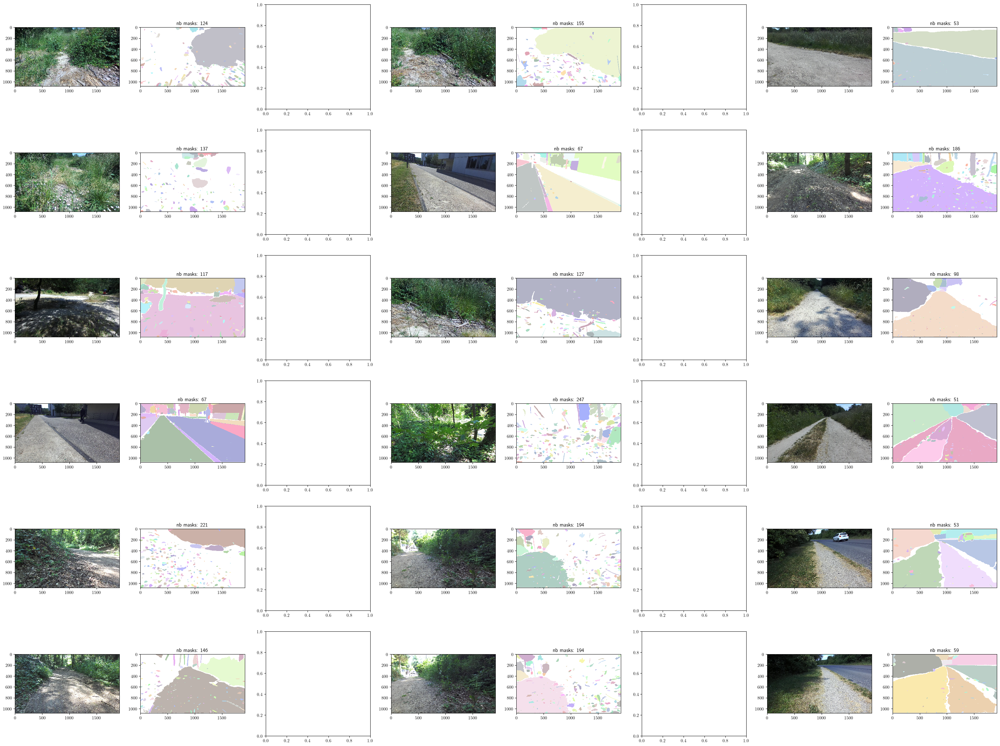

In [16]:
plot_tuned_SAM(pred_iou_thresh=0.0)

100%|██████████| 6/6 [03:19<00:00, 33.22s/it]


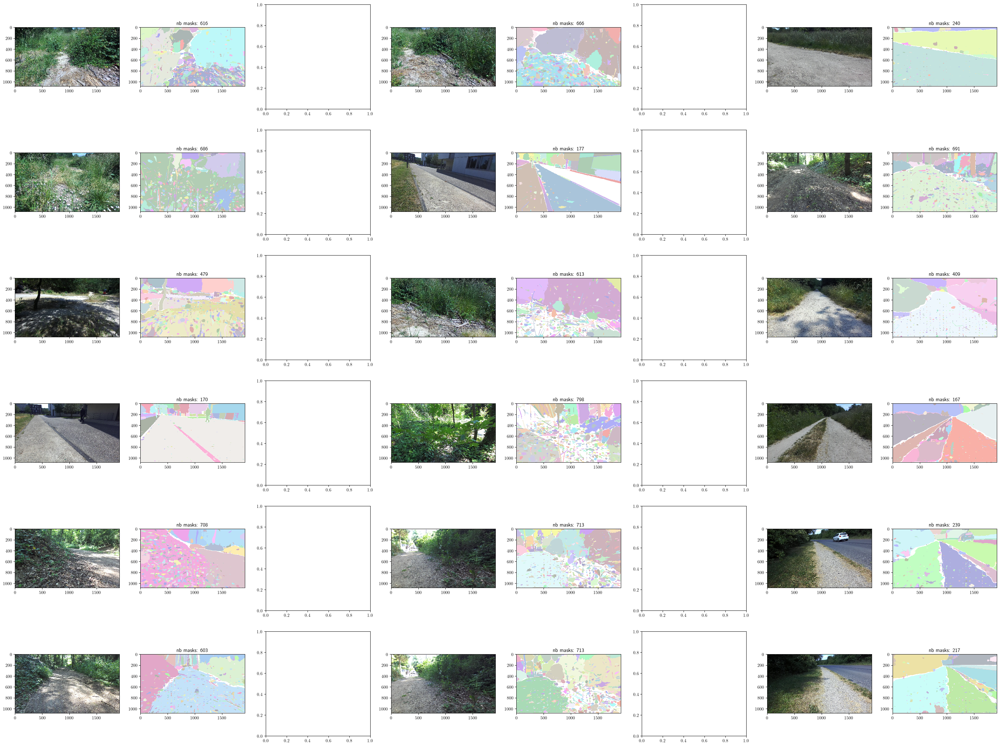

In [18]:
plot_tuned_SAM(pred_iou_thresh=0.0, stability_score_thresh=0.75)

100%|██████████| 6/6 [22:28<00:00, 224.67s/it]


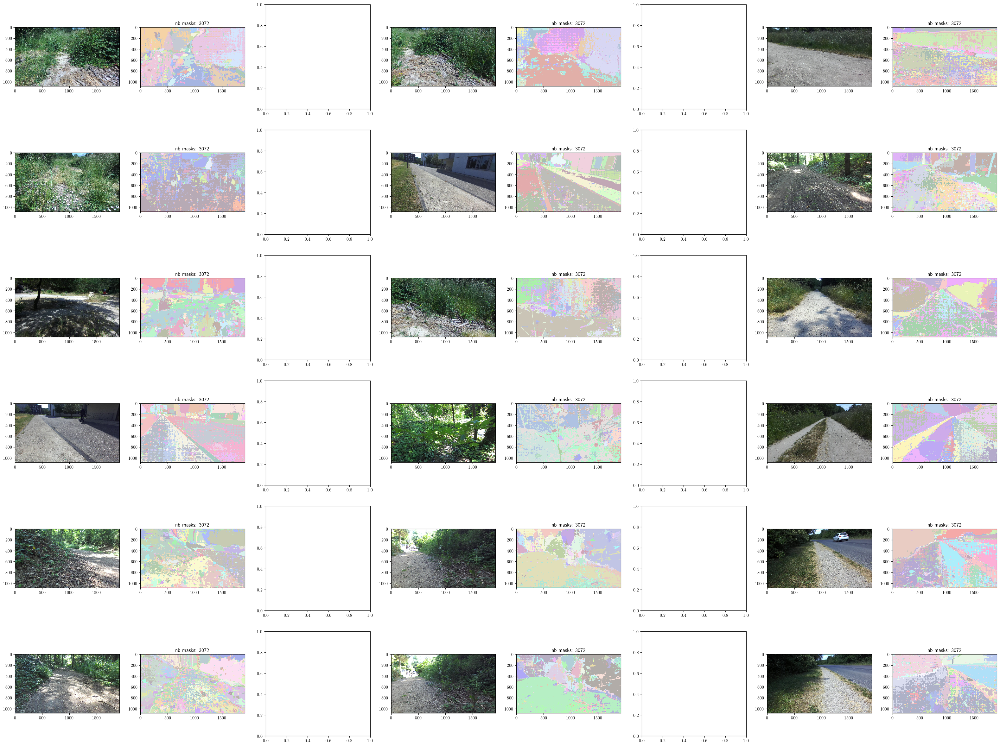

In [17]:
plot_tuned_SAM(
    pred_iou_thresh=0.0,
    stability_score_thresh=0.0,
    stability_score_offset=0.0,
    box_nms_thresh=1,
)

100%|██████████| 6/6 [01:35<00:00, 15.95s/it]


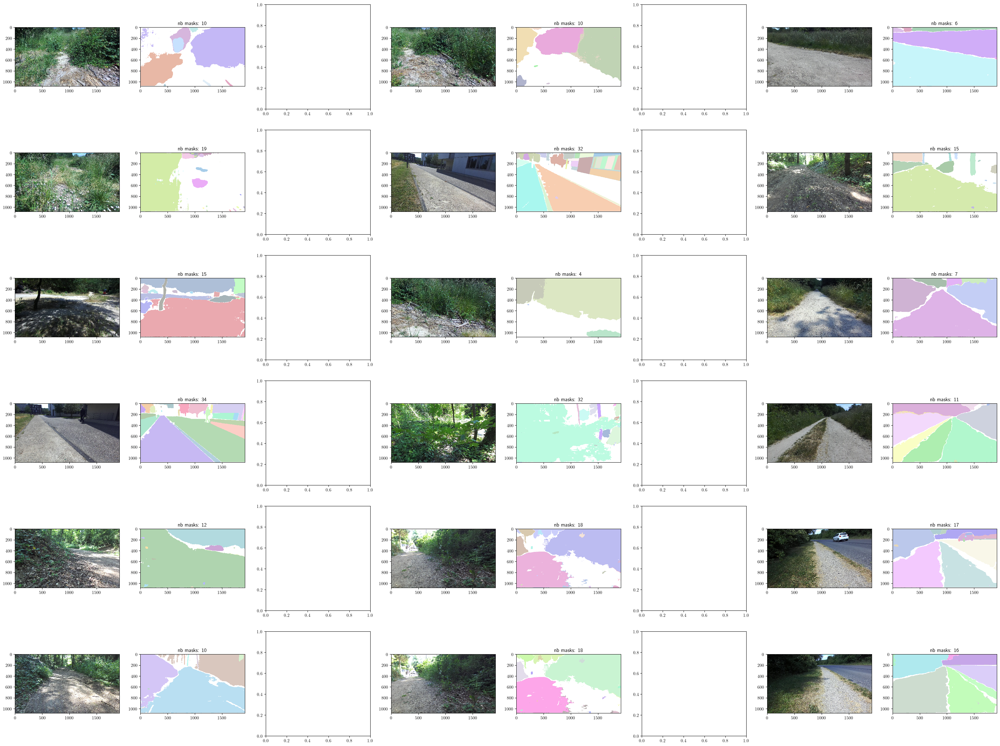

In [151]:
plot_tuned_SAM(pred_iou_thresh=0.95, stability_score_thresh=0.5)

100%|██████████| 6/6 [02:10<00:00, 21.74s/it]


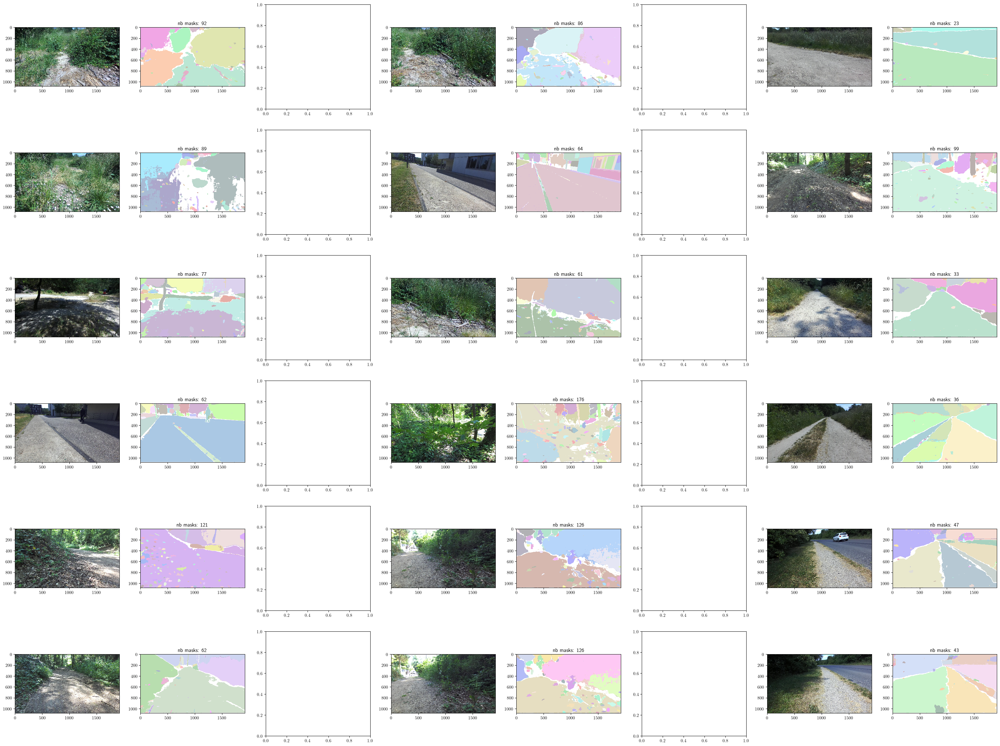

In [143]:
plot_tuned_SAM(stability_score_thresh=0.5)

100%|██████████| 6/6 [01:40<00:00, 16.73s/it]


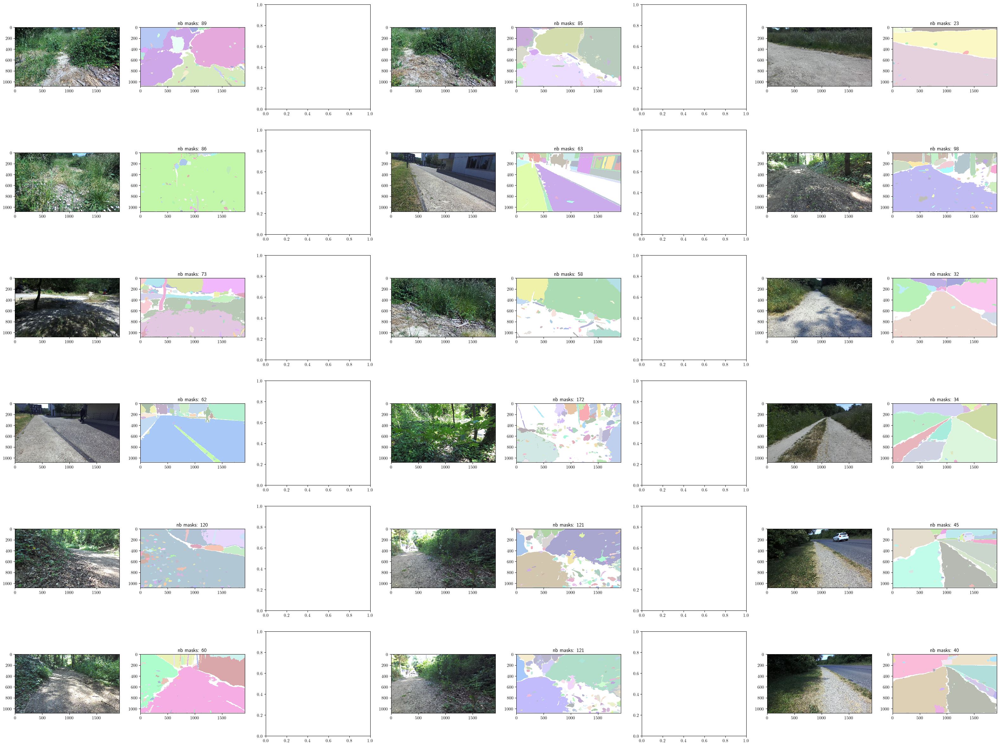

In [139]:
plot_tuned_SAM(stability_score_thresh=0.75)

100%|██████████| 6/6 [02:07<00:00, 21.30s/it]


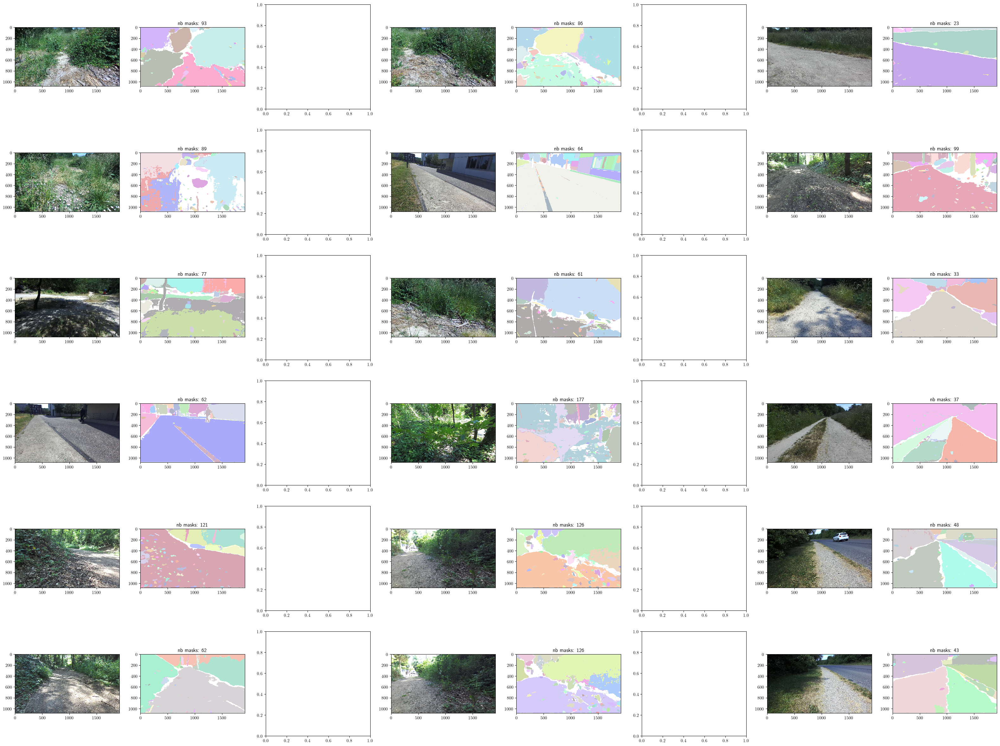

In [154]:
plot_tuned_SAM(stability_score_offset=0.8, stability_score_thresh=0.5)

  0%|          | 0/6 [00:00<?, ?it/s]

100%|██████████| 6/6 [01:31<00:00, 15.29s/it]


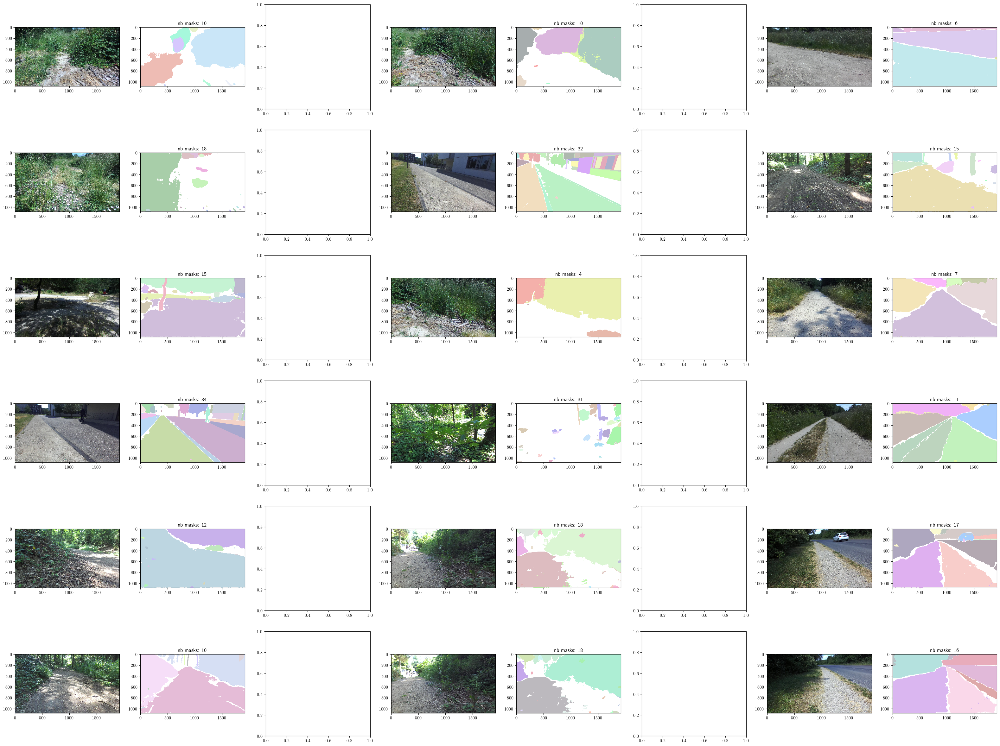

In [150]:
plot_tuned_SAM(pred_iou_thresh=0.95, stability_score_thresh=0.75)

## Automatic approach

In [55]:
from ray import tune
from ray.tune.search.optuna import OptunaSearch

from time import time


def eval_image(mask_generator, img_path):
    img = get_image(img_path)
    img = get_image(img_path)

    segmented_pxl = np.sum(
        reduce(np.logical_or, [m["segmentation"] for m in masks])
    )
    all_pxl = np.prod(img.shape[:2])

    nb_masks = len(masks)
    coverage = segmented_pxl / all_pxl * 100

    return coverage, nb_masks


def eval(config):
    from segment_anything import SamAutomaticMaskGenerator, sam_model_registry

    sam = sam_model_registry["vit_h"](
        checkpoint=PROJECT_PATH / "Testing_Results/sam_vit_h.pth"
    ).to("cuda")
    mask_generator = SamAutomaticMaskGenerator(sam, **config)

    total_nb_masks = 0
    coverage_list = []

    path_list = list(dir_path.glob("*[!nd].png"))
    start = time()
    for img_path in path_list:
        coverage, nb_masks = eval_image(mask_generator, img_path)

        coverage_list.append(coverage)
        total_nb_masks += nb_masks

    end = time()

    # Too many masks is too noisy and we won't be able to retrieve
    # anything relevant from it.
    # Too few (e.g. a single mask) is of no interest either.
    # So the goal is to maximaze the coverage, so that we have
    # a complete costmap, while minimizing the number of masks.
    mean_nb_masks = total_nb_masks / len(path_list)
    return {
        "time": end - start,
        "score": min(coverage_list) - abs(mean_nb_masks - 100) / 100,
        "mean coverage": np.mean(coverage_list),
        "mean nb_masks": mean_nb_masks,
    }


search_space = {
    # "points_per_side": tune.lograndint(10, 200),
    "pred_iou_thresh": tune.uniform(0, 1),
    "stability_score_thresh": tune.uniform(0, 1),
    "stability_score_offset": tune.uniform(0, 1),
    "box_nms_thresh": tune.uniform(0, 1),
    "min_mask_region_area": tune.lograndint(1, 1000),
}

In [56]:
algo = OptunaSearch()
gpu_eval = tune.with_resources(eval, {"cpu": 12, "gpu": 1})

tuner = tune.Tuner(
    gpu_eval,
    tune_config=tune.TuneConfig(
        metric="score",
        mode="max",
        search_alg=algo,
        num_samples=100,
    ),
    param_space=search_space,
)
results = tuner.fit()

In [59]:
from ray import tune

results = tune.Tuner.restore(
    "/home/g_thomas/ray_results/eval_2023-10-23_14-38-41", trainable=gpu_eval
).get_results()

In [60]:
results.get_best_result()

Result(
  metrics={'time': 946.3294856548309, 'score': 92.3688225308642, 'mean coverage': 99.17029441550926, 'mean nb_masks': 638.6},
  path='/home/g_thomas/ray_results/eval_2023-10-23_14-38-41/eval_30dfc115_95_box_nms_thresh=0.9759,min_mask_region_area=469,pred_iou_thresh=0.5630,stability_score_offset=0.8405,stability_sco_2023-10-24_09-40-52',
  filesystem='local',
  checkpoint=None
)

In [ ]:
results.get_best_result().config

(array([ 2.,  0.,  0.,  1.,  1.,  3.,  4.,  3.,  6.,  9., 14.,  3.,  7.,
        16.,  7.,  4.,  3.,  4.,  4.,  3.,  0.,  1.,  0.,  1.,  0.,  0.,
         0.,  1.,  1.,  2.]),
 array([   7.725     ,   51.58833333,   95.45166667,  139.315     ,
         183.17833333,  227.04166667,  270.905     ,  314.76833333,
         358.63166667,  402.495     ,  446.35833333,  490.22166667,
         534.085     ,  577.94833333,  621.81166667,  665.675     ,
         709.53833333,  753.40166667,  797.265     ,  841.12833333,
         884.99166667,  928.855     ,  972.71833333, 1016.58166667,
        1060.445     , 1104.30833333, 1148.17166667, 1192.035     ,
        1235.89833333, 1279.76166667, 1323.625     ]),
 <a list of 30 Patch objects>)

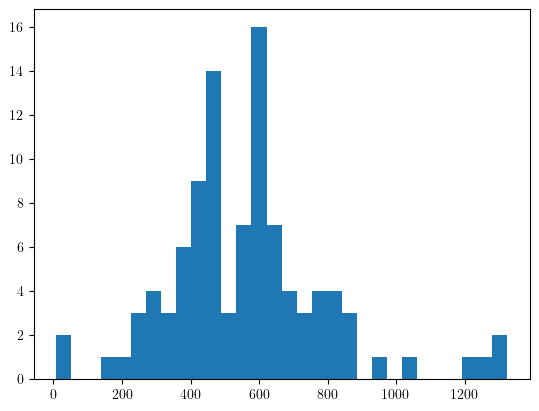

In [62]:
import matplotlib.pyplot as plt

df = results.get_dataframe()
plt.hist(df["mean nb_masks"], bins=30)

In [36]:
import plotly.express as px

fig = px.scatter(
    df, x="mean nb_masks", y="mean coverage", hover_data=df.columns
)
fig.show()

In [ ]:
# Did it solved the issues of the current dataset?
plot_tuned_SAM(
    pred_iou_thresh=0.68,
    stability_score_thresh=0.26,
    stability_score_offset=0.95,
    box_nms_thresh=0.58,
    min_mask_region_area=8,
)

In [ ]:
# Vs manual solution? (prefere the manual solution...)
plot_tuned_SAM(
    stability_score_thresh=0.5,
)

## Results on other images?

In [40]:
new_mask_generator = SamAutomaticMaskGenerator(sam, stability_score_thresh=0.5)
new_dir_path = PROJECT_PATH / "bagfiles/images_extracted/from_terrain_samples"


@interact()
def plot(img_path=new_dir_path.glob("*[!nd].png")):
    img = get_image(img_path)
    plt.imshow(img)

    masks = new_mask_generator.generate(img)
    color_mask = mask_to_color_annotation(masks)

    plt.gca().set_autoscale_on(False)
    plt.imshow(color_mask)

interactive(children=(Dropdown(description='img_path', options=(PosixPath('/home/g_thomas/Documents/PRE/bagfil…

# How to complete segmentation?
Study cancelled: it might not be relevant toward the creation of a dataset for the distillation process (easier to filter on the "completeness" of segmentation than lowering post-processings' thresholds and hence diminishing the robustness to light changes and producing over-segmentation).

(Use math morphology?)

In [ ]:
from scipy.ndimage import binary_dilation


def fill_segmentation(masks: list) -> list:  # XXX: function not finished
    """
    Fill segmentation masks from the largest to the smallest in order to
    form a complete segmentation (i.e. the union of all masks has no hole).

    Only necessary modification are kept.
    """
    if len(masks) == 0:
        raise ValueError("Empty list of masks provided.")

    union_mask = np.zeros_like(masks[0]["segmentation"], dtype=bool)
    complete_segmentation_list = []
    masks_to_process = sorted(masks, key=(lambda x: x["area"]))

    while not np.all(union_mask):
        mask = masks_to_process.pop(0)
        new_segmentation = binary_dilation(
            mask["segmentation"], structure=np.ones((3, 3))
        )
        # If the dilated segmentation does not change the union mask,
        # then it won't help us any further to fill the holes.
        # Save it and move on to the next mask.
        if new_segmentation | union_mask == union_mask:
            complete_segmentation_list.append(mask)
        else:
            masks_to_process.append(
                {
                    "segmentation": new_segmentation,
                    "area": new_segmentation.sum(),
                }
            )

        union_mask |= new_segmentation

    # TODO Add the remaining masks

    return complete_segmentation_list

# Compute costmap grid based on SAM's segmentation
SAM's costmap is computed at the image's resolution which is too high for the planification task.
We downsample it to the grid resolution used before.

In [60]:
@lru_cache
def get_sam_costmap(img_path: Path):
    img = get_image(img_path)
    depth = get_image(img_path.parent / (img_path.stem + "d.png"))
    normal = get_image(img_path.parent / (img_path.stem + "n.png"))

    masks = mask_generator.generate(img)
    masks = filter_intersection(masks)

    costmap = np.zeros_like(depth, dtype=np.float32)
    for mask in tqdm(masks):
        seg = mask["segmentation"]
        costmap[seg] = get_cost(mask, img, depth, normal)

    return img, costmap

100%|██████████| 89/89 [00:06<00:00, 12.83it/s]


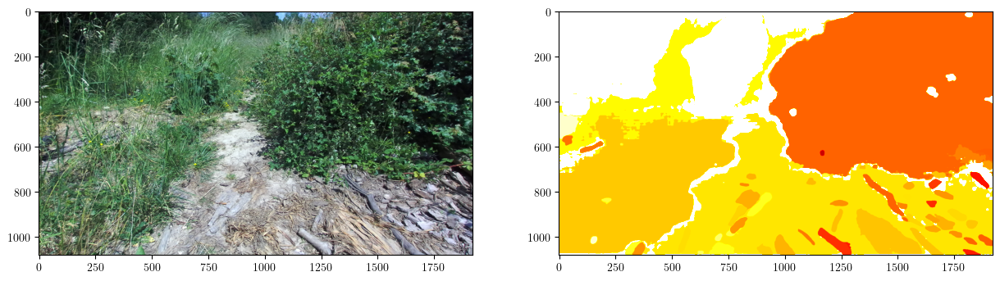

In [61]:
img, sam_costmap = get_sam_costmap(dir_path / "00015.png")

_, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 15))
ax1.imshow(img)
ax2.imshow(sam_costmap, cmap="hot_r", norm=norm)

In [219]:
import cv2

from src.utils.grid import get_grid_lists


def non_nul_max(x):
    x = x[x != 0]
    if len(x) == 0:
        return 0

    return np.max(x)


def downsample_to_grid(
    img: np.array, *, downsampling_fct=non_nul_max
) -> np.array:
    rectangle_list, grid_list = get_grid_lists()
    grid = np.zeros_like(rectangle_list, dtype=float)

    X, Y = rectangle_list.shape
    for x in range(X):
        for y in range(Y):
            patch = rectangle_list[x, y]
            if patch is None:
                continue

            poly_points = grid_list[x, y]
            poly_mask = np.zeros_like(img, dtype=np.uint8)
            poly_mask = cv2.fillPoly(poly_mask, [poly_points], True)

            pxls = img[poly_mask == True]
            grid[x, y] = downsampling_fct(pxls)

    return grid


costmap = downsample_to_grid(sam_costmap)

In [242]:
def get_sam_colored_costmap_with_grid(img_path: Path) -> np.array:
    _, sam_colored_costmap = get_colored_sam_costmap(img_path)
    sam_colored_costmap_with_grid = sam_colored_costmap.copy()
    rectangle_list, grid_list = get_grid_lists()

    # For each costmap element
    for x in range(X):
        for y in range(Y):
            patch = rectangle_list[y, x]
            if patch is None:
                continue

            # Display the center of the cell
            points_image = grid_list[y, x]
            centroid = np.mean(points_image, axis=0)
            cv2.circle(
                sam_colored_costmap_with_grid,
                tuple(np.int32(centroid)),
                radius=4,
                color=(0, 0, 1, 1),
                thickness=-1,
            )

            # Display the frontiers of the cell
            points_image_reshape = points_image.reshape((-1, 1, 2))
            cv2.polylines(
                sam_colored_costmap_with_grid,
                np.int32([points_image_reshape]),
                True,
                (0, 1, 0, 1),
                3,
            )

    return sam_colored_costmap_with_grid


sam_colored_costmap_with_grid = get_sam_colored_costmap_with_grid(
    dir_path / "00015.png"
)

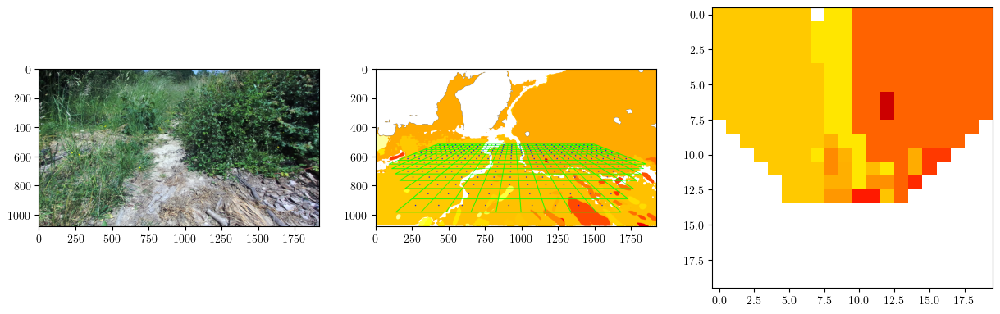

In [220]:
# Note: You might see a slight divergence of color between ax2 and ax3.
# This is due to the recomputation of the costmap (and hence resampling random patches,
# which most likely will have different cost values).
# Converting the "sam_costmap" (which has the cost) to a colored costmap is not
# efficient as it requires to apply the "colormap.to_rgba" function to each pixel
# (which is quite a lot on a 1920x1080 resolution image, and therefore is slow to do...).

_, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 15))
ax1.imshow(img)
ax2.imshow(sam_colored_costmap_with_grid)
ax3.imshow(costmap[::-1, :], cmap="hot_r", norm=norm)

In [223]:
for img_path in tqdm(list(dir_path.glob("*[!nd].png")), desc="Precomputing"):
    add_grid(img_path)
    get_sam_costmap(img_path)

Precomputing: 100%|██████████| 40/40 [11:25<00:00, 17.14s/it]


In [248]:
@interact()
def plot(img_path=dir_path.glob("*[!nd].png")):
    img, sam_costmap = get_sam_costmap(img_path)
    sam_colored_costmap_with_grid = get_sam_colored_costmap_with_grid(img_path)
    costmap = downsample_to_grid(sam_costmap)

    _, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 15))
    ax1.imshow(img)
    ax2.imshow(sam_colored_costmap_with_grid)
    colormap = ax3.imshow(costmap[::-1, :], cmap="hot_r", norm=norm)

    plt.colorbar(colormap, ax=ax3, shrink=0.2)

interactive(children=(Dropdown(description='img_path', options=(PosixPath('/home/g_thomas/Documents/PRE/bagfil…